<a href="https://colab.research.google.com/github/ShiwangiMishra-Git/Object-detection-Using-MobileNet-SSD/blob/main/MobileNet_%2B_SSD_Project_Report.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Object detection Using MobileNet + SSD**
### Project Report - Intro to Machine Learning

 Shiwangi Mishra (SM9175@nyu.edu);
Saili Kulkarni (SNK9486@nyu.edu)



**Introduction:**

The main objective of this project report is to demonstrate the analysis of the MobileNetSSD model which is a Single-Shot multibox Detection (SSD) network intended to perform object detection.


**Motivation:**

Object detection is one of the most prominent fields of research in computer vision today. It is an extension of image classification, where the goal is to identify one or more classes of objects in an image and localize their presence with the help of bounding boxes. Hence, Object detection and recognition is applied in many areas of computer vision, including image retrieval, security, surveillance, automated license plate recognition, optical character recognition, traffic control, medical field, agricultural field and many more.

Classic object detectors are based on sliding window approach (DPM), which is computationally intensive due to the exhaustive search but is rapidly rendered obsolete by the rise of region proposals with (R-CNN, Fast R-CNN), this approach introduces a selective search algorithm for finding potential objects, performs relatively better, but has its constraints, since the search algorithm is a decoupled process from training it would generate false positives and forward them to training, this combined with the complex pipeline makes it computationally expensive as well as slow with 0.4 frames per second (fps) for Fast R-CNN.

Faster-RCNN solves the issue of disjoint pipeline by replacing the external region proposal algorithm with an embedded Region Proposal Network (RPN) which makes it a unified network, achieving 73.2 mAP on Pascal VOC2007 test set, but remaining considerably slow for real-time detection applications with 7 fps.

The next significant improvement in the history of object detection was to drop region proposals altogether and predict bounding box coordinates and confidence class scores directly from the image, one stage detectors, this structural simplicity enables real-time predictions. Introducing You Only Look Once (YOLO) a simplified network processing 21 fps and achieving an accuracy of 66.4 mAP on Pascal VOC2007, you may notice that by increasing speed we risk reducing the accuracy of the detector, this reframes the detection question as how the speed vs accuracy trade-off can be further improved.

This is where SSD with VGG -16 as base network, was introduced performing faster namely to YOLO with 46 fps and a competitive accuracy to Faster-RCNN with 74.3 mAP. However there was a major scope of improvement in inference speed by replacing VGG16 by more efficient and lighweight MobileNet SSD that reduced the computation time while keeping the accuracy similar.

Hence SSD+MobileNetV1 with an efficient CNN architecture designed for mobile and embedded vision application. This architecture uses proven depth-wise separable convolutions to build lightweight deep neural networks.

Data Sets:

Our model is a SSD-based object detection model trained on Open Images V4 with ImageNet pre-trained MobileNet V2 as image feature extractor.







#**Model Architecture - Single Shot MultiBox Detector (VGG16 + SSD)**




[Source - SSD: Single Shot MultiBox Detector (VGG16 + SSD)](https://www.researchgate.net/figure/mobileNet-SSD-network-architecture_fig3_332553794)

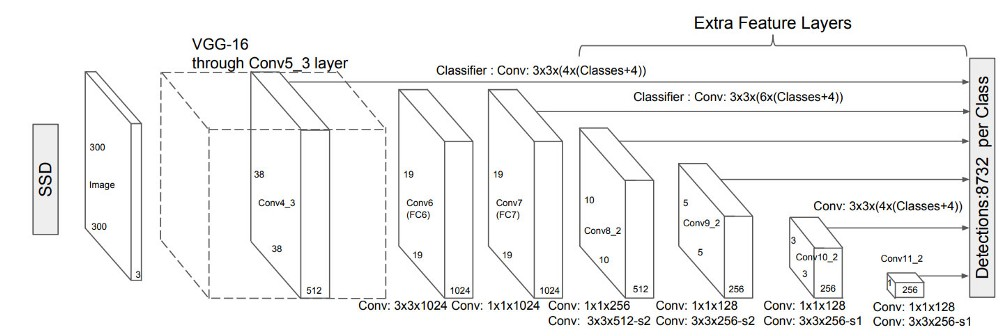

Image Source : [SSD object detection](https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06)

The SSD object detection composes of 2 parts:

* Extract feature maps
* Apply convolution filters to detect objects.


# **Extract feature maps**



**VGG16:** A VGG-16 model, pre-trained on ImageNet for image classification, is used as the backbone network. The authors make a few slight tweaks when adapting the model for the detection task, including: replacing fully connected layers with convolutional implementations, removing dropout layers, and replacing the last max pooling layer with a dilated convolution.

SSD uses VGG16 to extract feature maps. Then it detects objects using the Conv4_3 layer. For illustration, we draw the Conv4_3 to be 8 × 8 spatially (it should be 38 × 38). For each cell (also called location), it makes 4 object predictions.



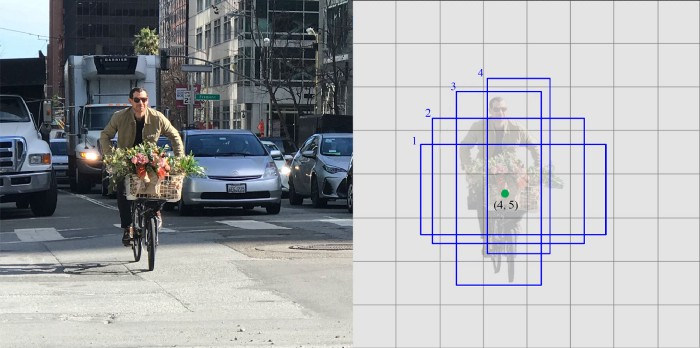

Image Source : [SSD object detection](https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06)

Each prediction composes of a boundary box and 21 scores for each class (one extra class for no object), and we pick the highest score as the class for the bounded object. Conv4_3 makes a total of 38 × 38 × 4 predictions: four predictions per cell regardless of the depth of the feature maps. As expected, many predictions contain no object. SSD reserves a class “0” to indicate it has no objects.

**Making multiple predictions containing boundary boxes and confidence scores is called multibox.**

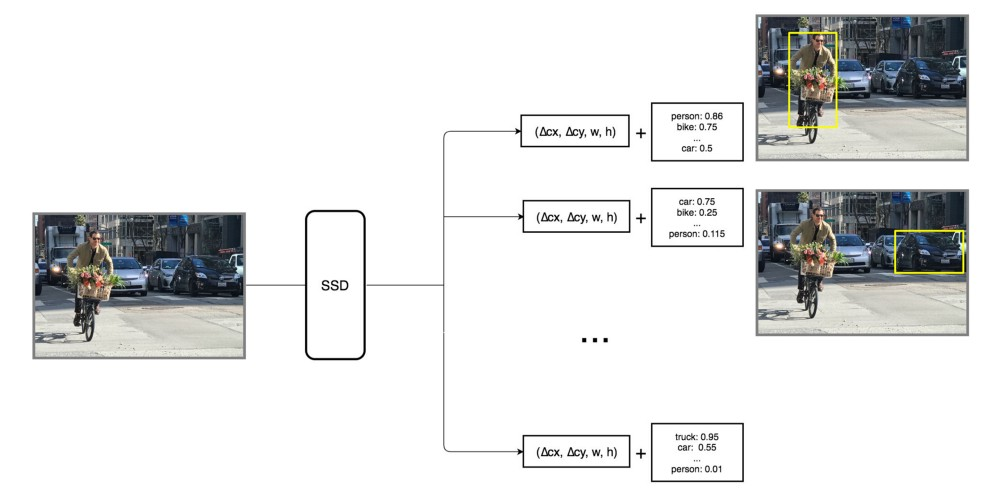

Image Source : [SSD object detection](https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06)

# **Apply convolution filters to detect objects**

**Convolutional predictors for object detection :** SSD does not use a delegated region proposal network. Instead, it resolves to a very simple method. It computes both the location and class scores using small convolution filters. After extracting the feature maps, SSD applies 3 × 3 convolution filters for each cell to make predictions. (These filters compute the results just like the regular CNN filters.) Each filter outputs 25 channels: 21 scores for each class plus one boundary box.

For example, in Conv4_3, we apply four 3 × 3 filters to map 512 input channels to 25 output channels.



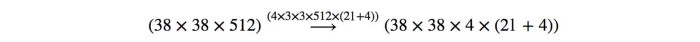

Image Source : [SSD object detection](https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06)

**Multi-scale feature maps:** Above, we described how SSD detects objects from a single layer. Actually, it uses multiple layers (multi-scale feature maps) to detect objects independently. As CNN reduces the spatial dimension gradually, the resolution of the feature maps also decrease. SSD uses lower resolution layers to detect larger scale objects. For example, the 4× 4 feature maps are used for larger scale object.

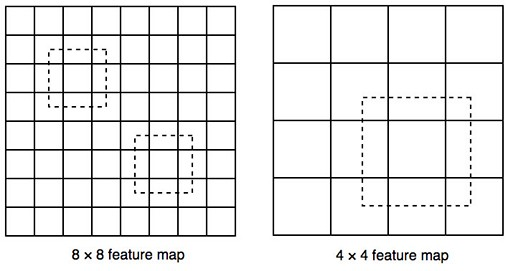

Image Source : [SSD object detection](https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06)

SSD adds 6 more auxiliary convolution layers after the VGG16. Five of them will be added for object detection. In three of those layers, we make 6 predictions instead of 4. In total, SSD makes 8732 predictions using 6 layers.


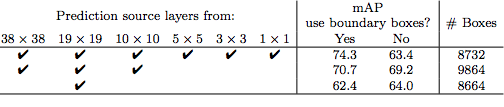

Image Source : [SSD object detection](https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06)

**Default boundary box:** The default boundary boxes are equivalent to anchors in Faster R-CNN.

These default boxes are pre-selected manually and carefully to cover a wide spectrum of real-life objects. SSD also keeps the default boxes to a minimum (4 or 6) with one prediction per default box. Now, instead of using global coordination for the box location, the boundary box predictions are relative to the default boundary boxes at each cell (∆cx, ∆cy, w, h), i.e. the offsets to the default box at each cell.
For each feature map layers, it shares the same set of default boxes centered at the corresponding cell. But different layers use different sets of default boxes to customize object detections at different resolutions. 

Default boundary boxes are chosen manually. SSD defines a scale value for each feature map layer. Starting from the left, Conv4_3 detects objects at the smallest scale 0.2 (or 0.1 sometimes) and then increases linearly to the rightmost layer at a scale of 0.9. Combining the scale value with the target aspect ratios, we compute the width and the height of the default boxes. For layers making 6 predictions, SSD starts with 5 target aspect ratios: 1, 2, 3, 1/2 and 1/3. Then the width and the height of the default boxes are calculated as shown below and and aspect ratio = 1:


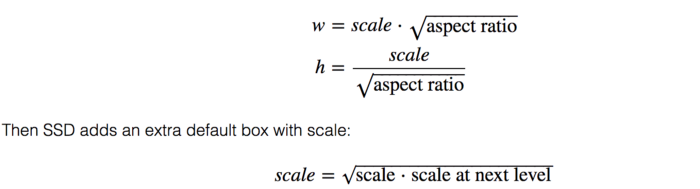

Image Source : [SSD object detection](https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06)

**Matching strategy:**

SSD predictions are classified as positive matches or negative matches. SSD only uses positive matches in calculating the localization cost (the mismatch of the boundary box). If the corresponding default boundary box (not the predicted boundary box) has an IoU greater than 0.5 with the ground truth, the match is positive. Otherwise, it is negative. (IoU, the intersection over the union, is the ratio between the intersected area over the joined area for two regions.)

**This matching strategy encourages each prediction to predict shapes closer to the corresponding default box. Therefore our predictions are more diverse and more stable in the training.**

**Multi-scale feature maps & default boundary boxes:**

Higher resolution feature maps are responsible for detecting small objects. The first layer for object detection conv4_3 has a spatial dimension of 38 × 38, a pretty large reduction from the input image. Hence, SSD usually performs badly for small objects comparing with other detection methods. If it is a problem, we can mitigate it by using images with higher resolution.



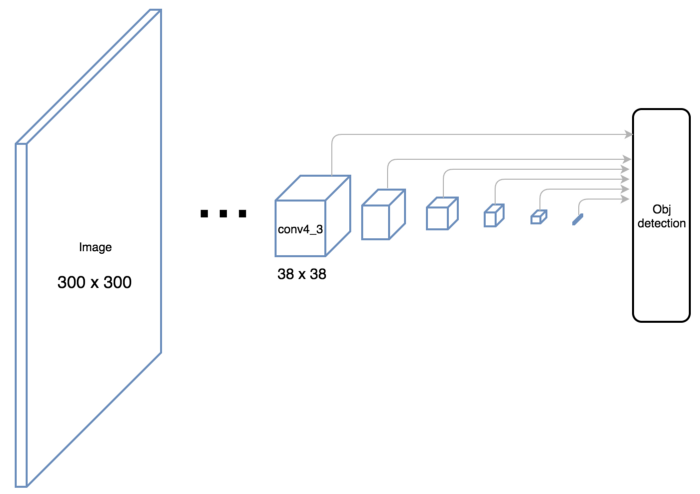

Image Source : [SSD object detection](https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06)

Here is an example of how SSD combines multi-scale feature maps and default boundary boxes to detect objects at different scale. The dog below matches one default box (in red) in the 4 × 4 feature map layer, but not any default boxes in the higher resolution 8 × 8 feature map. The cat which is smaller is detected only by the 8 × 8 feature map layer in 2 default boxes (in blue).

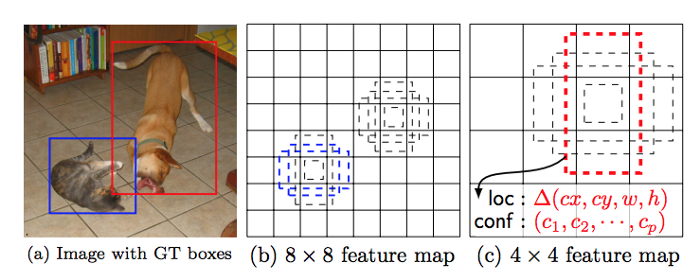

Image Source : [SSD object detection](https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06)

# **Loss function**


**The localization loss** is the mismatch between the ground truth box and the predicted boundary box. SSD only penalizes predictions from positive matches. We want the predictions from the positive matches to get closer to the ground truth. Negative matches can be ignored.

\Image VGG11

Image Source : [SSD object detection](https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06)

**The confidence loss** is the loss in making a class prediction. For every positive match prediction, we penalize the loss according to the confidence score of the corresponding class. For negative match predictions, we penalize the loss according to the confidence score of the class “0”: class “0” classifies no object is detected.


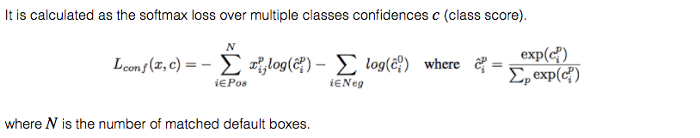

Image Source : [SSD object detection](https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06)

**The final loss function is computes as:**


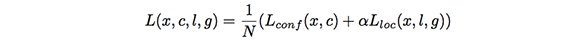

Image Source : [SSD object detection](https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06)

where N is the number of positive match and α is the weight for the localization loss.

## **Inference time**


SSD makes many predictions (8732) for a better coverage of location, scale and aspect ratios, more than many other detection methods. However, many predictions contain no object. Therefore, any predictions with class confidence scores lower than 0.01 will be eliminated.

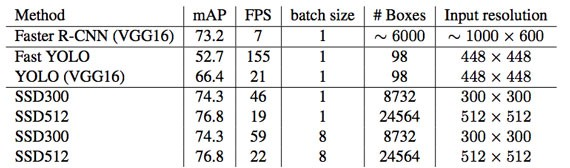

Image Source : [SSD object detection](https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06)

## **Experimental Results and Training Data Sets:**

The model is trained using SGD with initial learning rate 0.001 , 0.9 momentum, 0.0005 weight decay, and batch size 32. Using a Nvidia Titan X on VOC2007 test, SSD achieves 59 FPS with mAP 74.3% on VOC2007 test, vs. Faster R-CNN 7 FPS with mAP 73.2% or YOLO 45 FPS with mAP 63.4%.

Here is the accuracy comparison for different methods. For SSD, it uses image size of 300 × 300 or 512 × 512. 

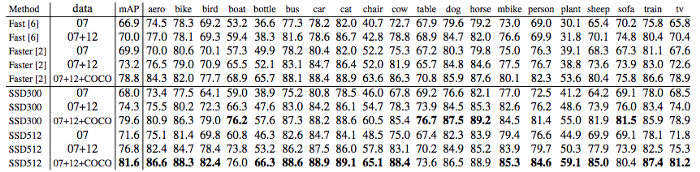

Image Source : [SSD object detection](https://medium.com/@jonathan_hui/ssd-object-detection-single-shot-multibox-detector-for-real-time-processing-9bd8deac0e06)

**Single Shot MultiBox Detector (MobileNet + SSD)**





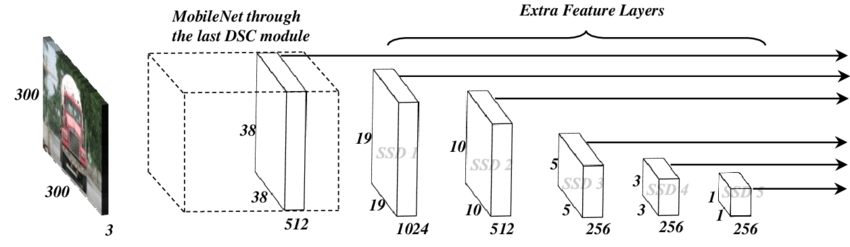


Image Source: [Single Shot MultiBox Detector (MobileNet + SSD)](https://www.researchgate.net/figure/mobileNet-SSD-network-architecture_fig3_332553794)

# **MoblieNetV1 replaces VGG16 as a base model in SSD:**
MobileNetV1 uses depthwise Separable convolution for extracting feature maps which is comparitively lighter model than VGG16



**Depthwise separable convolution** It reduces the model size and complexity and is particularly useful for mobile and embedded vision applications.
Smaller model size: Fewer number of parameters
Smaller complexity: Fewer Multiplications and Additions (Multi-Adds)

* Depthwise convolution is the channel-wise DK×DK spatial convolution. Suppose in the figure above, we have 5 channels, then we will have 5 DK×DK spatial convolution.
* Pointwise convolution actually is the 1×1 convolution to change the dimension.



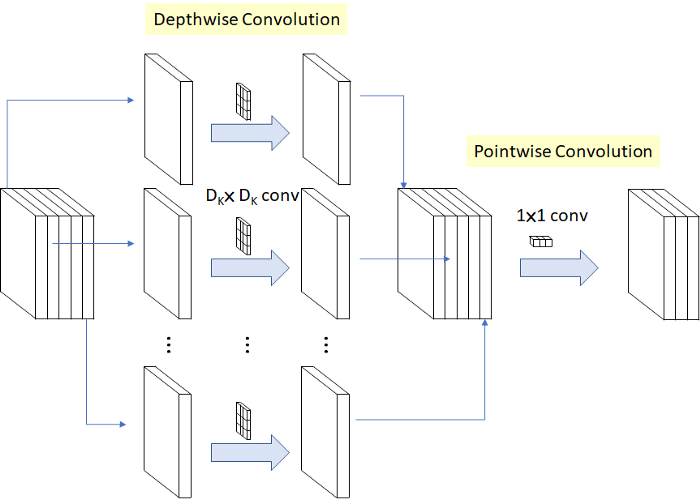

Image Source : [MobileNetV2 — Light Weight Model](https://towardsdatascience.com/review-mobilenetv2-light-weight-model-image-classification-8febb490e61c)

Image Source : [MobileNets: Efficient Convolutional Neural Networks for Mobile Vision
Applications](https://arxiv.org/pdf/1704.04861v1.pdf)


With above operation, the operation cost is:


Depthwise Separable Convolution Cost: Depthwise Convolution Cost (Left), Pointwise Convolution Cost (Right)

where M: Number of input channels, N: Number of output channels, DK: Kernel size, and DF: Feature map size.

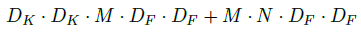

For standard convolution, convolution cost is:


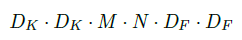



Thus, the computation reduction is:

Depthwise Separable Convolution Cost / Standard Convolution Cost

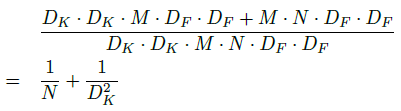

When DK×DK is 3×3, 8 to 9 times less computation can be achieved, but with only small reduction in accuracy.


**Width Multiplier α is introduced to control the input width of a layer, which makes M become αM.** α is between 0 to 1, with typical settings of 1, 0.75, 0.5 and 0.25. When α=1, it is the baseline MobileNet. And the computational cost and the number of parameters can be reduced quadratically by roughly α².Accuracy drops off smoothly from α=1 to 0.5 until α=0.25 which is too small.

**Resolution Multiplier ρ is introduced to control the input image**

resolution of the network, with Resolution Multiplier ρ, the cost become:



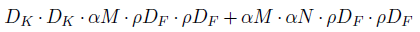

where ρ is between 0 to 1. And the input resolution is 224, 192, 160, and 128. When ρ=1, it is the baseline MobileNet.
Accuracy drops off smoothly across resolution from 224 to 128.

**In the above version of MobileNet which is called MobileNetV1**, Depthwise Separable Convolution was introduced which dramatically reduced the complexity cost and model size of the network, which is suitable to Mobile devices, or any devices with low computational power. 

**In MobileNetV2, a better module is introduced with inverted residual structure.** Non-linearities in narrow layers are removed this time. With MobileNetV2 as backbone for feature extraction, state-of-the-art performances are also achieved for object detection and semantic segmentation.

# **MobileNetV2 replaces MobileNetV1 as a base model in SSD:**


**Comparison MobileNetV1 vs MobileNetV2**

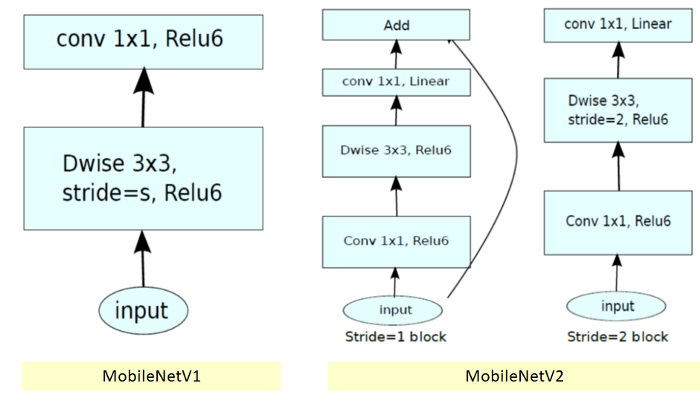


Image Source : [MobileNetV2 — Light Weight Model](https://towardsdatascience.com/review-mobilenetv2-light-weight-model-image-classification-8febb490e61c)

In MobileNetV2 a better module is introduced with inverted residual structure. Non-linearities in narrow layers are removed this time. With MobileNetV2 as backbone for feature extraction, state-of-the-art performances are also achieved for object detection and semantic segmentation.

**In MobileNetV1,** 

There are 2 layers and ReLU6 is used here for comparison.
* The first layer is called a depthwise convolution 
* The second layer is a 1×1 convolution, called a pointwise convolution


**In MobileNetV2,**

There are two types of blocks. 
* One is residual block with stride of 1. 
* Another one is block with stride of 2 for downsizing.

There are 3 layers for both types of blocks.
* The first layer is 1×1 convolution with ReLU6.
* The second layer is the depthwise convolution.
* The third layer is another 1×1 convolution but without any non-linearity. 

**There is an expansion factor t in this module. t=6 for all main experiments.**
If the input got 64 channels, the internal output would get 64×t=64×6=384 channels.

# **MobileNetV2 Overall Architecture**



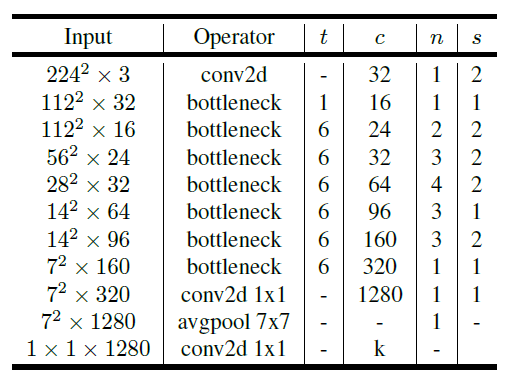

where t: expansion factor, c: number of output channels, n: repeating number, s: stride. 3×3 kernels are used for spatial convolution.

In typical, the primary network (width multiplier 1, 224×224), has a computational cost of 300 million multiply-adds and uses 3.4 million parameters. (Width multiplier is introduced in MobileNetV1.)
The performance trade offs are further explored, for input resolutions from 96 to 224, and width multipliers of 0.35 to 1.4.

The network computational cost up to 585M MAdds, while the model size vary between 1.7M and 6.9M parameters.

To train the network, 16 GPU is used with batch size of 96.


# **Experimental Results and Training Data Sets:**


**Object Detection**

SSD is evaluated
with 300 input resolution (SSD 300) and Faster-RCNN is
compared with both 300 and 600 input resolution (FasterRCNN 300, Faster-RCNN 600). The Faster-RCNN model
evaluates 300 RPN proposal boxes per image. The models
are trained on COCO train+val excluding 8k minival images.



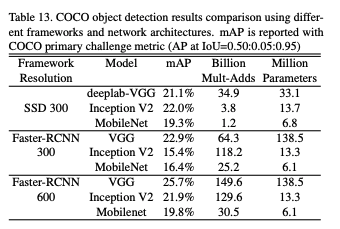

Image Source : [MobileNets: Efficient Convolutional Neural Networks for Mobile Vision
Applications](https://arxiv.org/pdf/1704.04861v1.pdf)

Many other datasets are also tried to prove the effectiveness of MobileNet:

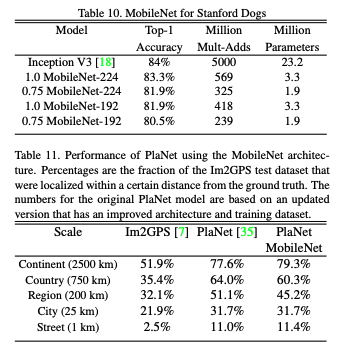

Image Source : [MobileNets: Efficient Convolutional Neural Networks for Mobile Vision
Applications](https://arxiv.org/pdf/1704.04861v1.pdf)


## **Replication:**


We replicated three notebooks:


1.   Object Detection tutorial : [Link to Replicated Notebook](https://colab.research.google.com/drive/16yMFZF1rfQnFw438r70VloaU8it9Cet5?authuser=1#scrollTo=uazJ5ASc2_QE)
   * This colab notebook demonstrates use of a Tensor Flow - Hub module trained to perform object detection.
   * Major components of the notebook:

      > Notebook imports various TF modules, Numpy,Matplotlib, Python Imaging Library functions and modules 

      >Notebook has helper functions for downloading images and for visualization.

      >Notebook loads a public image from Open Images v4, save locally, and display

      > Notebooks has capability to pick an object detection module (FasterRCNN+InceptionResNet and ssd+mobilenet V2) and apply on the downloaded image. 
      > Notebook also has the capablity to display inference time for each image detection task

Below is the output of object detection task performed by SSD+MobileNetV2 model. We can see the we have got bounding boxes with lable and score associated with each object detected in the image.







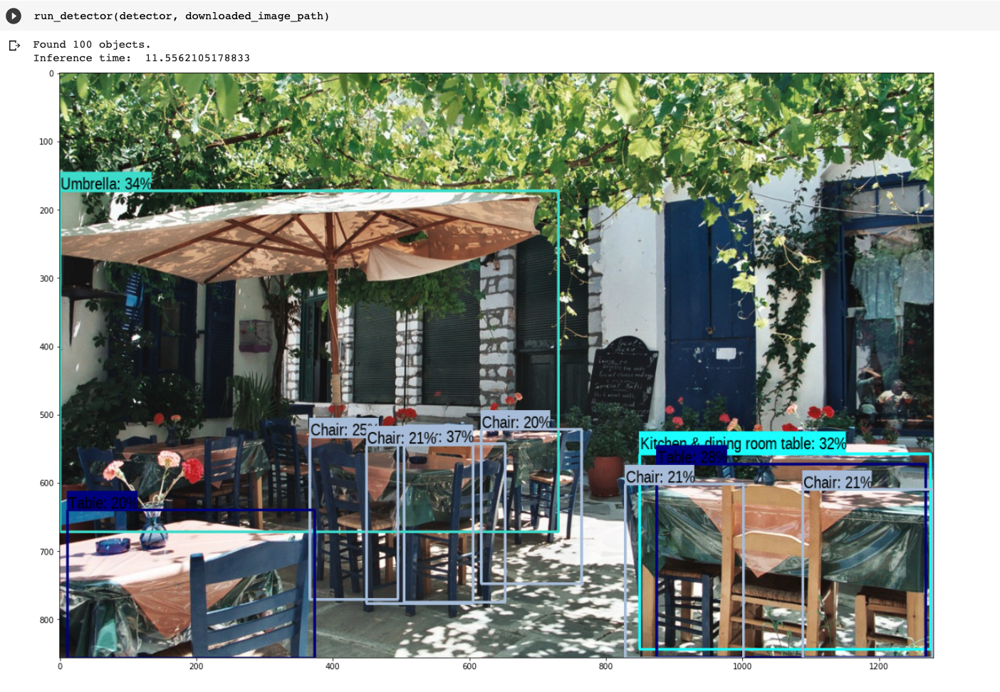


2.   Object Detection with SSD on Video: [Link to Replicated Notebook](https://colab.research.google.com/drive/1EfAr2ciC5-ivnmrf7BKSne8FLHgC3_Qz?authuser=1)

   * This notebook uses a PyTorch port of SSD: Single Shot MultiBox Detector to detect objects on a given youtube video.
   * Major components of the notebook:
     > Notebook imports various TF modules, Numpy, Matplotlib liberaries 

      > Notebook downloads the SSD300 pretrained model

      >It prepares model for detection by fixing some errors present in the model and calls build_ssd function of ssd module which is the constructor to build the architecture of single shot multibox architecture and provied test method which process the viedo, resizes the frames, perform object detection using SSDMobileNetV2 on the given video and builds the capapility to draw bozes and text over the video frames based upon the infrence output and scores.

     <!-- **Code Fixes done by us to run the code:**
     Below is the given image you can see the code snipped inclosed in a squre box.  cv2.VideoWriter() was not able to write output in MP4 therefore we changed the ouptput in .avi extension
      -->





<!-- 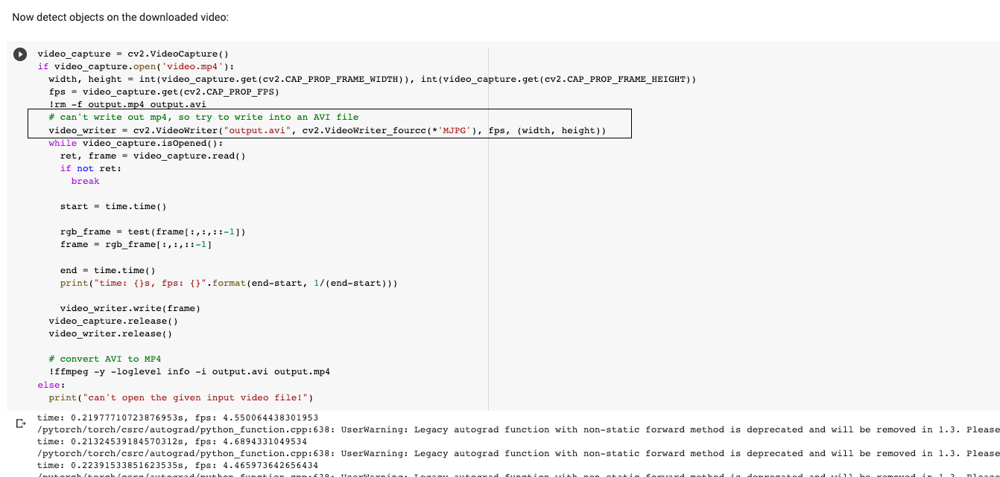 -->


Below is the output of object detection task performed by SSD+MobileNetV2 model. We can see the we have got bounding boxes with lable and score associated with each object detected in the test video.




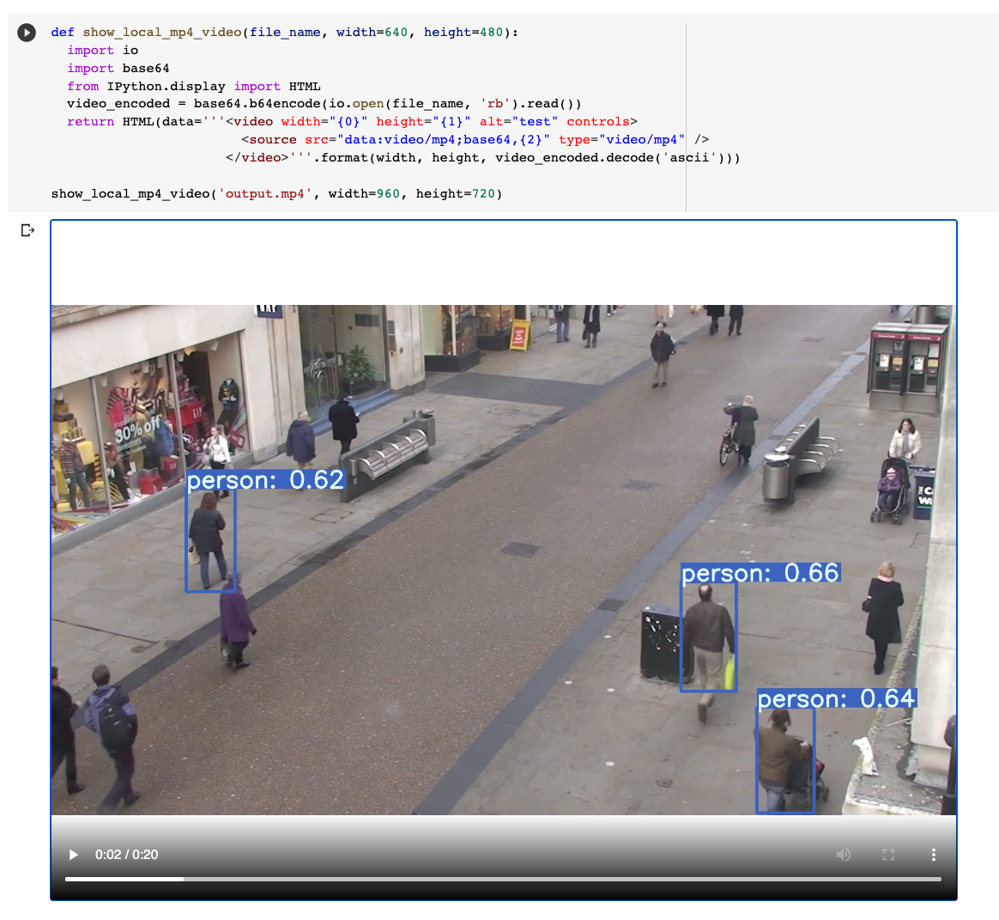



3.  Training MobileNetSSD Object Detection on a Custom Dataset : [Link to Replicated Notebook](https://colab.research.google.com/drive/1kS51I7a4T_BMN-GuR1cuhlYti8prhOlP?authuser=1#scrollTo=uQCnYPVDrsgx)
  * This notebook demonstrates how to train a MobileNet object detection model using the TensorFlow 1.5 Object Detection API.

   * Major components of the notebook:
    > **Data:**
This notebook uses an open source cell dataset called BCCD (Blood Cell Count and Detection). This dataset contains 364 images (and 4888 annotations!) is hosted publicly on Roboflow.

     >**Model Selection for Training:**
This notebook performs training of a MobileNetSSDv2 model (single shot detector) and also provided option to train Faster RCNN model as well 

     >**Inference:** This notebook run inference directly in the notebook, and on three test images contained in the "test" folder from our GitHub repo.
When adapting to your a diffrennt custom dataset, we have to add test images to the test folder located at tensorflow-object-detection/test.

     >**Configs and Hyperparameters:** This notebook supports a variety of models, more pretrained model can be found at [Tensorflow detection model zoo: COCO-trained models](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/detection_model_zoo.md#coco-trained-models), as well as their pipline config files in [object_detection/samples/configs/](https://github.com/tensorflow/models/tree/master/research/object_detection/samples/configs). It provides the capability to configure these models as per the reuirements and train accordingly.

     >It downloads base model and cofigures the training pipline and then performs training on the custom dataset. Once training is complete,it extracts the newly trained inference graph, which will be later used to perform the object detection. 

     >It also gives option to download frozen inference graph for later use.

     > Then it performs testing with images in repository tensorflow-object-detection/test directory.To test with custom images, we need to place our images inside the test directory in this Colab notebook.
     > It performs object detection using run_inference_for_single_image method. This method uses trained model to perform inference and optputs the bounding boxes and scores.

     



    

Below is the output of object detection task performed by SSD+MobileNetV2 model. We can see the we have got bounding boxes with lable and score associated with each blood cells detected in the test image.


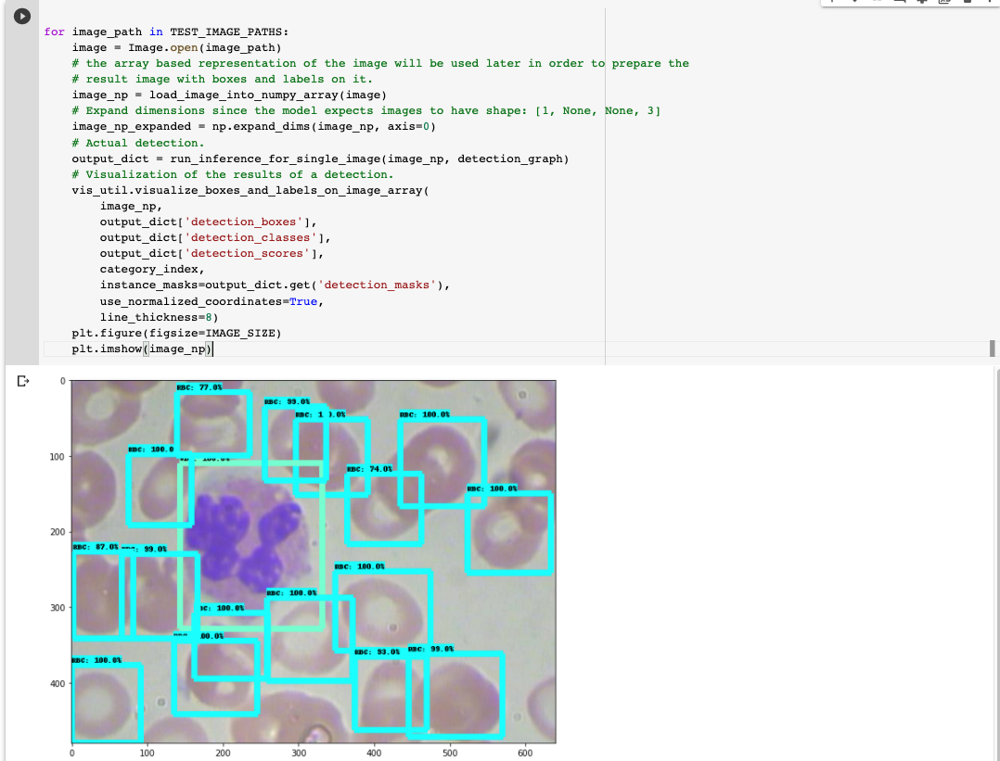

##**Extension:**


[Link to Extension Notebook (Comparison between SSDMObileNetV4 and Faster RCNN)](https://colab.research.google.com/drive/1z1jvgALnNFpdlEmkk97A6ZAymmaRMzjh?userstoinvite=sm9175%40nyu.edu&actionButton=1&authuser=1#scrollTo=CxmDMK4yupqg)





## Comparisoning Faster RCNN and SSD based upon memory usage and infrence time

In [ ]:
#@title Imports and function definitions

# For running inference on the TF-Hub module.
import tensorflow as tf

import tensorflow_hub as hub

# For downloading the image.
import matplotlib.pyplot as plt
import tempfile
from six.moves.urllib.request import urlopen
from six import BytesIO

# For drawing onto the image.
import numpy as np
from PIL import Image
from PIL import ImageColor
from PIL import ImageDraw
from PIL import ImageFont
from PIL import ImageOps

#for drawing plots
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# For measuring the inference time.
import time

# Print Tensorflow version
print(tf.__version__)

# Check available GPU devices.
print("The following GPU devices are available: %s" % tf.test.gpu_device_name())

2.3.0
The following GPU devices are available: 


In [ ]:
!pip install -U memory_profiler
%load_ext memory_profiler



Requirement already up-to-date: memory_profiler in /usr/local/lib/python3.6/dist-packages (0.58.0)


### Helper functions for downloading images and for visualization.



In [ ]:
def display_image(image):
  fig = plt.figure(figsize=(20, 15))
  plt.grid(False)
  plt.imshow(image)


def download_and_resize_image(url, new_width=256, new_height=256,
                              display=False):
  _, filename = tempfile.mkstemp(suffix=".jpg")
  response = urlopen(url)
  image_data = response.read()
  image_data = BytesIO(image_data)
  pil_image = Image.open(image_data)
  pil_image = ImageOps.fit(pil_image, (new_width, new_height), Image.ANTIALIAS)
  pil_image_rgb = pil_image.convert("RGB")
  pil_image_rgb.save(filename, format="JPEG", quality=90)
  print("Image downloaded to %s." % filename)
  if display:
    display_image(pil_image)
  return filename


def draw_bounding_box_on_image(image,
                               ymin,
                               xmin,
                               ymax,
                               xmax,
                               color,
                               font,
                               thickness=4,
                               display_str_list=()):
  """Adds a bounding box to an image."""
  draw = ImageDraw.Draw(image)
  im_width, im_height = image.size
  (left, right, top, bottom) = (xmin * im_width, xmax * im_width,
                                ymin * im_height, ymax * im_height)
  draw.line([(left, top), (left, bottom), (right, bottom), (right, top),
             (left, top)],
            width=thickness,
            fill=color)

  # If the total height of the display strings added to the top of the bounding
  # box exceeds the top of the image, stack the strings below the bounding box
  # instead of above.
  display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
  # Each display_str has a top and bottom margin of 0.05x.
  total_display_str_height = (1 + 2 * 0.05) * sum(display_str_heights)

  if top > total_display_str_height:
    text_bottom = top
  else:
    text_bottom = top + total_display_str_height
  # Reverse list and print from bottom to top.
  for display_str in display_str_list[::-1]:
    text_width, text_height = font.getsize(display_str)
    margin = np.ceil(0.05 * text_height)
    draw.rectangle([(left, text_bottom - text_height - 2 * margin),
                    (left + text_width, text_bottom)],
                   fill=color)
    draw.text((left + margin, text_bottom - text_height - margin),
              display_str,
              fill="black",
              font=font)
    text_bottom -= text_height - 2 * margin


def draw_boxes(image, boxes, class_names, scores, max_boxes=10, min_score=0.1):
  """Overlay labeled boxes on an image with formatted scores and label names."""
  colors = list(ImageColor.colormap.values())

  try:
    font = ImageFont.truetype("/usr/share/fonts/truetype/liberation/LiberationSansNarrow-Regular.ttf",
                              25)
  except IOError:
    print("Font not found, using default font.")
    font = ImageFont.load_default()

  for i in range(min(boxes.shape[0], max_boxes)):
    if scores[i] >= min_score:
      ymin, xmin, ymax, xmax = tuple(boxes[i])
      display_str = "{}: {}%".format(class_names[i].decode("ascii"),
                                     int(100 * scores[i]))
      color = colors[hash(class_names[i]) % len(colors)]
      image_pil = Image.fromarray(np.uint8(image)).convert("RGB")
      draw_bounding_box_on_image(
          image_pil,
          ymin,
          xmin,
          ymax,
          xmax,
          color,
          font,
          display_str_list=[display_str])
      np.copyto(image, np.array(image_pil))
  return image

## Apply module

Load a public image from Open Images v4, save locally, and display.

Image downloaded to /tmp/tmpcrjjqejb.jpg.


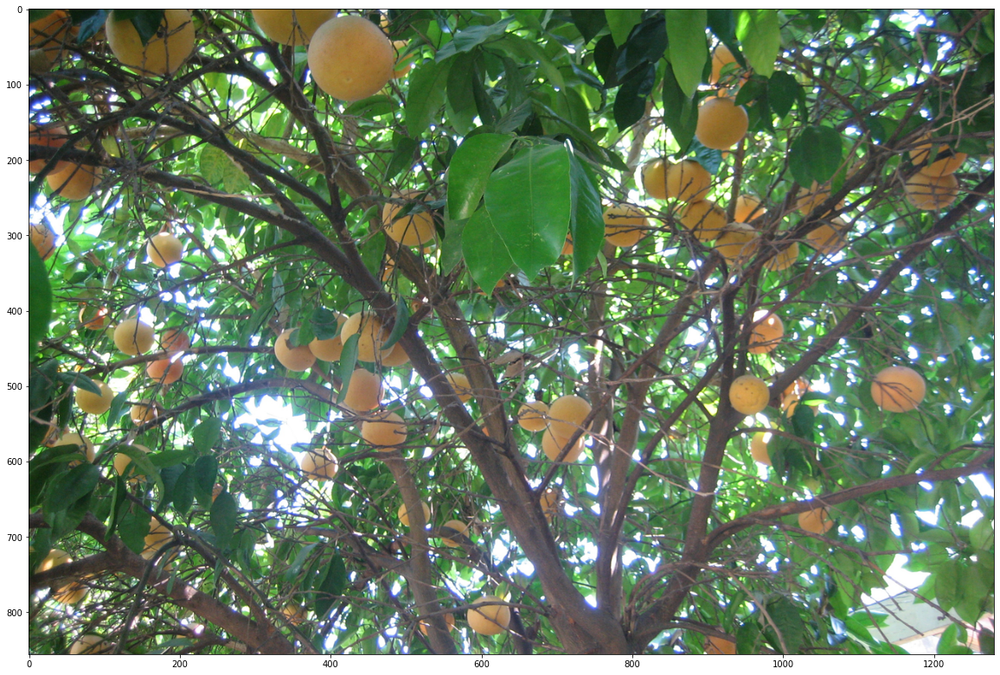

In [ ]:
# By Heiko Gorski, Source: https://commons.wikimedia.org/wiki/File:Naxos_Taverna.jpg
image_url =   "https://farm6.staticflickr.com/1038/825874698_acb51b52bd_o.jpg"#@param
downloaded_image_path = download_and_resize_image(image_url, 1280, 856, True)

Pick an object detection module and apply on the downloaded image. Modules for comparision:
* **FasterRCNN+InceptionResNet V2**: high accuracy,
* **ssd+mobilenet V2**: small and fast.

In [ ]:
module_handleSSD = "https://tfhub.dev/google/openimages_v4/ssd/mobilenet_v2/1" #@param ["https://tfhub.dev/google/openimages_v4/ssd/mobilenet_v2/1", "https://tfhub.dev/google/faster_rcnn/openimages_v4/inception_resnet_v2/1"]
module_handleRCNN = "https://tfhub.dev/google/faster_rcnn/openimages_v4/inception_resnet_v2/1" #@param ["https://tfhub.dev/google/openimages_v4/ssd/mobilenet_v2/1", "https://tfhub.dev/google/faster_rcnn/openimages_v4/inception_resnet_v2/1"]
detectorSSD = hub.load(module_handleSSD).signatures['default']
detectorRCNN = hub.load(module_handleRCNN).signatures['default']

INFO:tensorflow:Saver not created because there are no variables in the graph to restore


INFO:tensorflow:Saver not created because there are no variables in the graph to restore


INFO:tensorflow:Saver not created because there are no variables in the graph to restore


INFO:tensorflow:Saver not created because there are no variables in the graph to restore


In [ ]:
def load_img(path):
  img = tf.io.read_file(path)
  img = tf.image.decode_jpeg(img, channels=3)
  return img

In [ ]:
def run_detectorSSD(detectorSSD, path):
  img = load_img(path)

  converted_img  = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]
  start_time = time.time()
  result = detectorSSD(converted_img)
  end_time = time.time()

  result = {key:value.numpy() for key,value in result.items()}

  print("Found %d objects." % len(result["detection_scores"]))
  print("Inference time: ", end_time-start_time)

  image_with_boxes = draw_boxes(
      img.numpy(), result["detection_boxes"],
      result["detection_class_entities"], result["detection_scores"])
  
  display_image(image_with_boxes)

def run_detectorRCNN(detectorRCNN, path):
  img = load_img(path)

  converted_img  = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]
  start_time = time.time()
  result = detectorRCNN(converted_img)
  end_time = time.time()

  result = {key:value.numpy() for key,value in result.items()}

  print("Found %d objects." % len(result["detection_scores"]))
  print("Inference time: ", end_time-start_time)

  image_with_boxes = draw_boxes(
      img.numpy(), result["detection_boxes"],
      result["detection_class_entities"], result["detection_scores"])

  display_image(image_with_boxes)

SSD
Found 100 objects.
Inference time:  6.25929594039917
peak memory: 8583.53 MiB, increment: 0.13 MiB


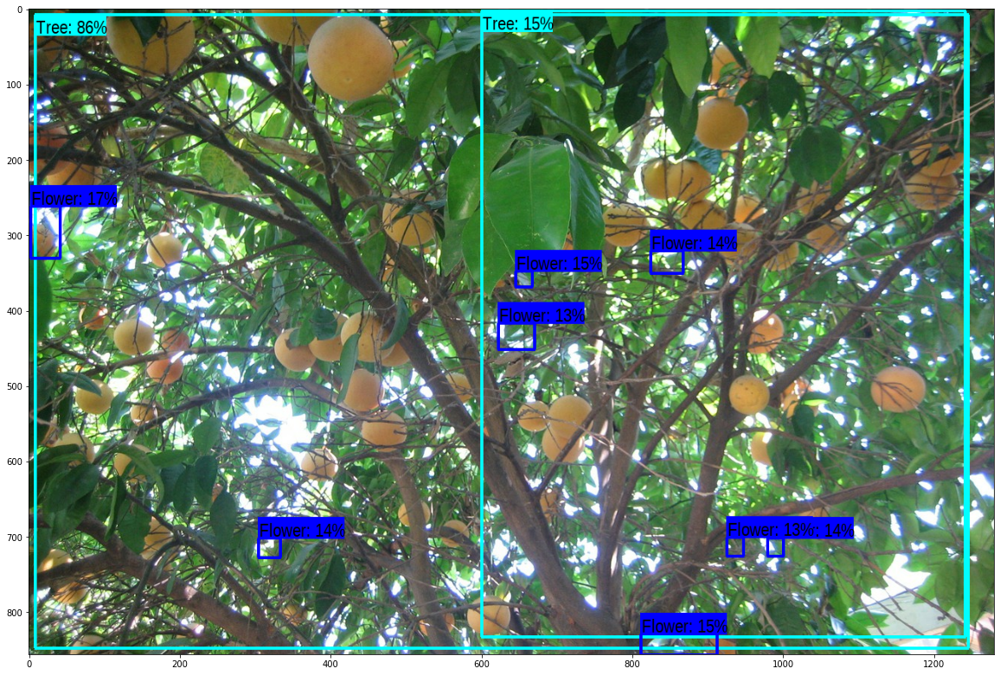

In [ ]:
print('SSD')
%memit run_detectorSSD(detectorSSD, downloaded_image_path)


RCNN
Found 100 objects.
Inference time:  62.67364287376404
peak memory: 9574.60 MiB, increment: 991.18 MiB


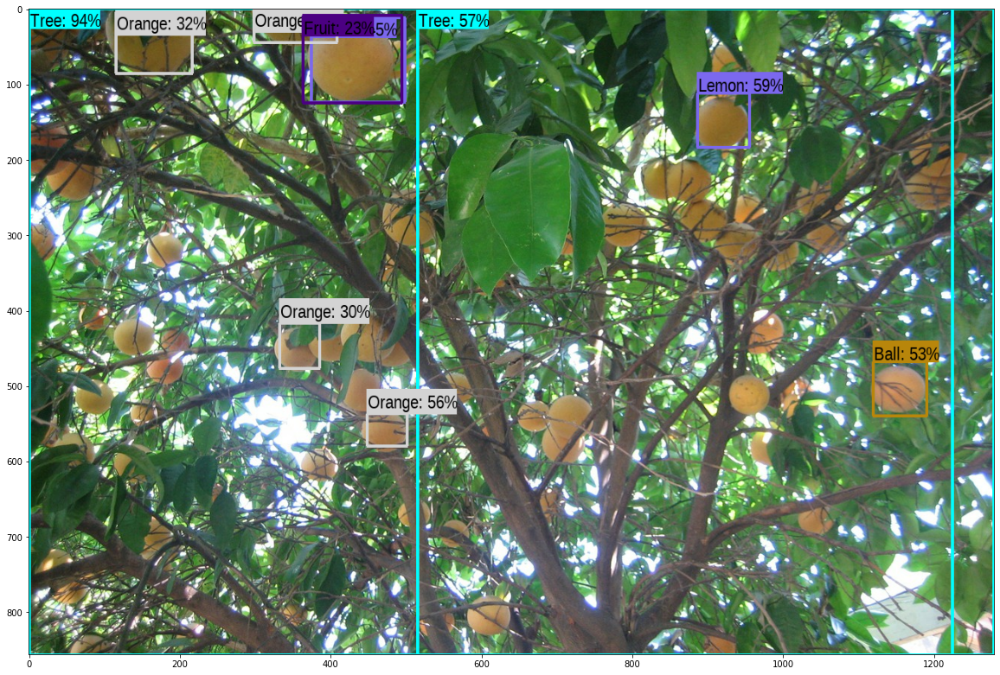

In [ ]:
print('RCNN')
%memit run_detectorRCNN(detectorRCNN, downloaded_image_path)

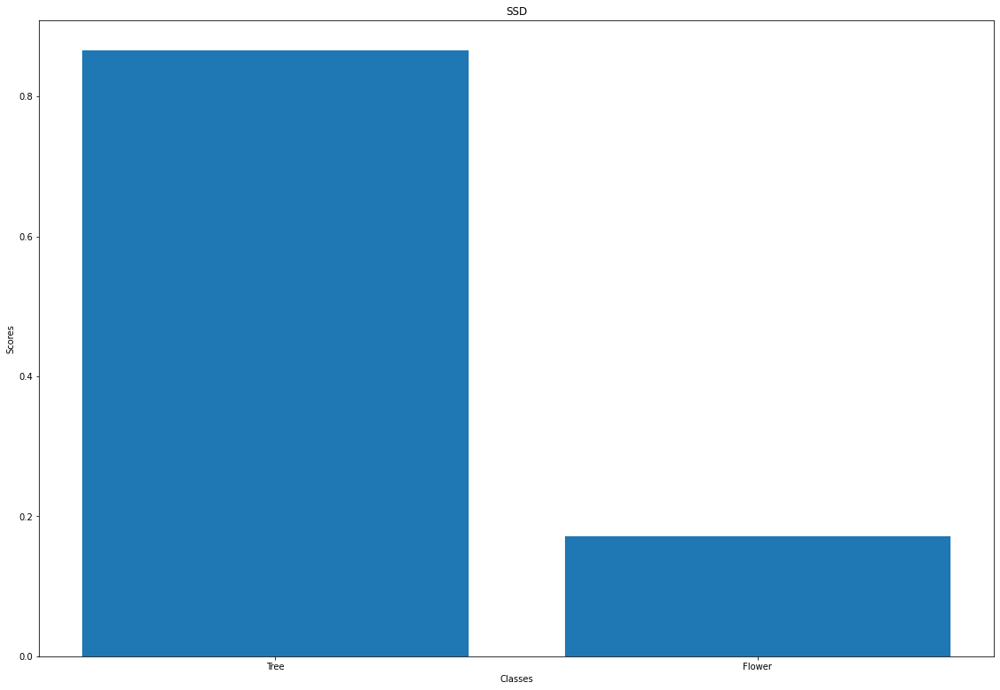

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
img = load_img(downloaded_image_path)
converted_img  = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]
result = detectorSSD(converted_img)


fig = plt.figure()
ax = fig.add_axes([0,0,2.5,2.5])
classPlot =result["detection_class_entities"].numpy()

scoresPlot = result["detection_scores"].numpy()

ax.bar(classPlot,scoresPlot)
ax.set_ylabel('Scores')
ax.set_xlabel('Classes')

plt.title("SSD")
plt.show()




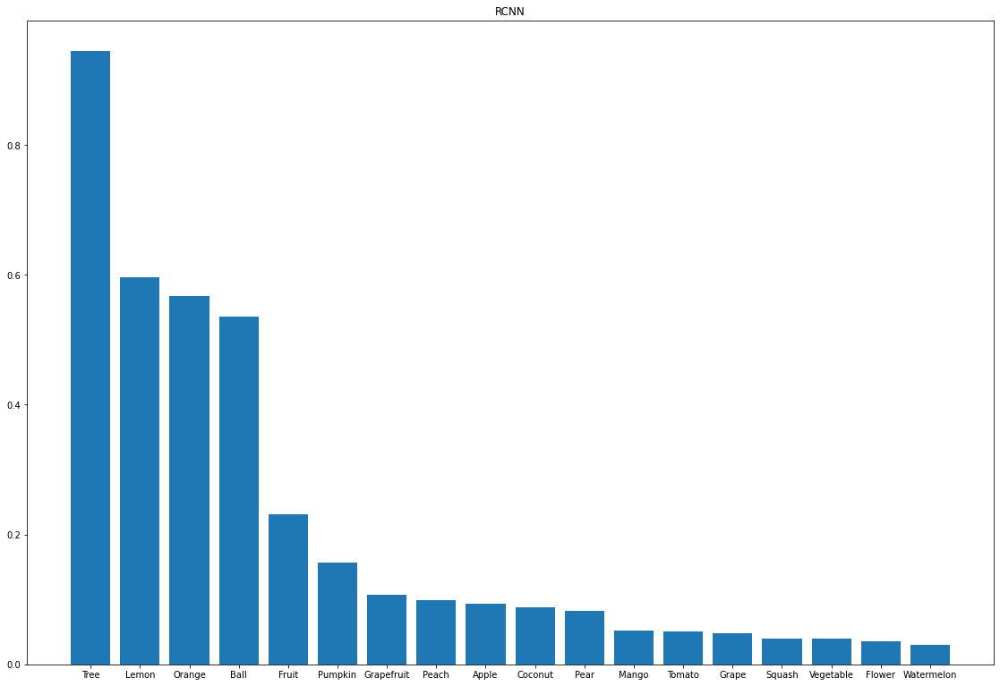

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
img = load_img(downloaded_image_path)
converted_img  = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]
result = detectorRCNN(converted_img)


fig = plt.figure()
ax = fig.add_axes([0,0,2.5,2.5])
langs =result["detection_class_entities"].numpy()

students = result["detection_scores"].numpy()

ax.bar(langs,students)
plt.title("RCNN")
plt.show()




### More images
Perform inference on some additional images with time tracking.


In [ ]:
image_urls = [
  # Source: https://commons.wikimedia.org/wiki/File:The_Coleoptera_of_the_British_islands_(Plate_125)_(8592917784).jpg
  "https://farm4.staticflickr.com/2430/3816987115_51c9ecb6a6_o.jpg",
  # By Américo Toledano, Source: https://commons.wikimedia.org/wiki/File:Biblioteca_Maim%C3%B3nides,_Campus_Universitario_de_Rabanales_007.jpg
  "https://media.guestofaguest.com/t_article_content/gofg-media/2017/03/1/48517/bamontes_.jpg", 
 # Source: https://commons.wikimedia.org/wiki/File:The_smaller_British_birds_(8053836633).jpg
"https://c8.staticflickr.com/9/8747/17196717922_7d863775be_o.jpg",
"https://farm4.staticflickr.com/2430/3816987115_51c9ecb6a6_o.jpg",
"https://farm5.staticflickr.com/7483/15727112689_d58eb27954_o.jpg",
"https://farm4.staticflickr.com/5275/5898922758_77cd7cc51a_o.jpg"
  ]

def detect_imgSSD(image_url):
  start_time = time.time()
  image_path = download_and_resize_image(image_url, 640, 480)
  run_detectorSSD(detectorSSD, image_path)
  end_time = time.time()
  #print("Inference time:",end_time-start_time)
def detect_imgRCNN(image_url):
  start_time = time.time()
  image_path = download_and_resize_image(image_url, 640, 480)
  run_detectorRCNN(detectorRCNN, image_path)
  end_time = time.time()
 #print("Inference time:",end_time-start_time)

SSD
Image downloaded to /tmp/tmpswc3x6p9.jpg.
Found 100 objects.
Inference time:  0.3497447967529297
peak memory: 9602.72 MiB, increment: 1.26 MiB

RCNN
Image downloaded to /tmp/tmpijjvjyl7.jpg.
Found 100 objects.
Inference time:  31.692911863327026
peak memory: 9621.12 MiB, increment: 18.51 MiB


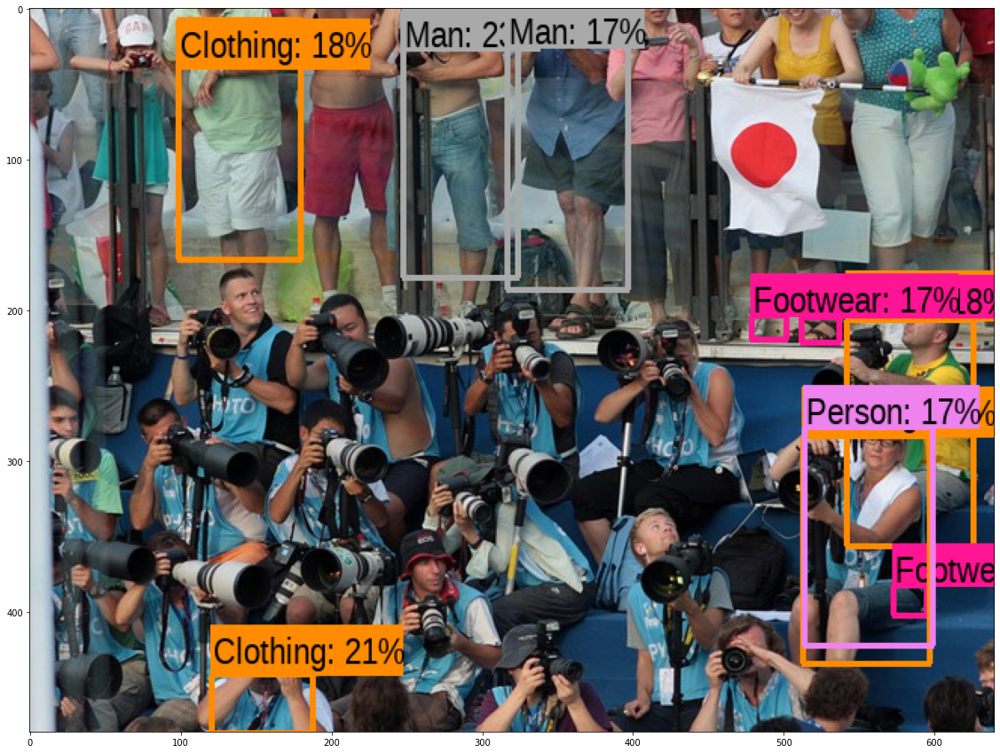

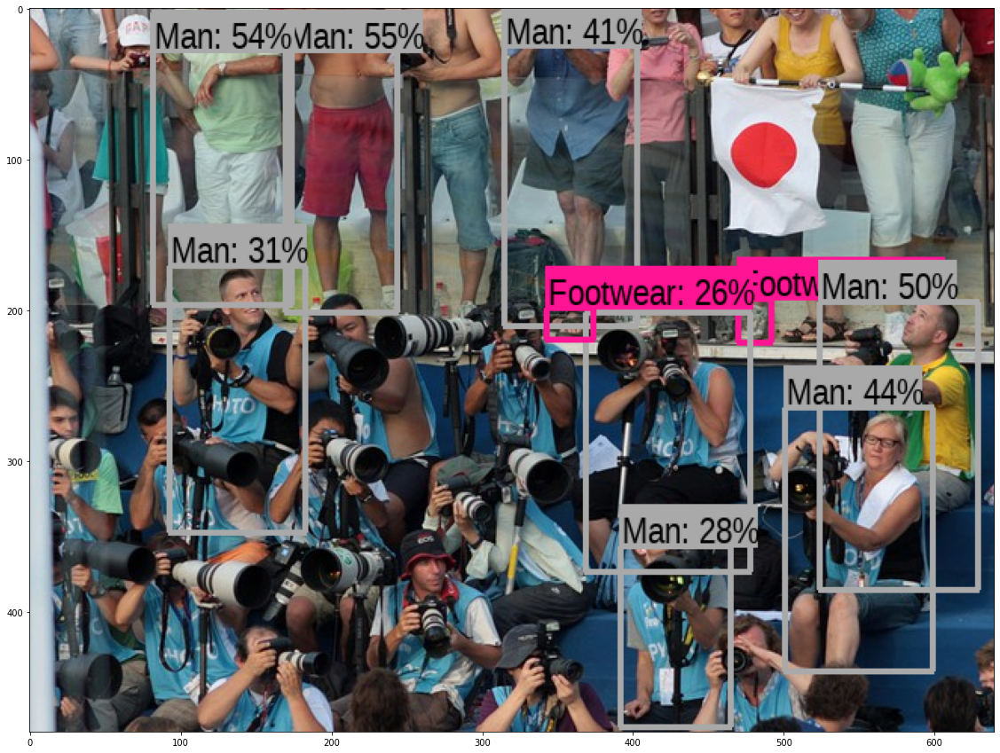

In [ ]:
print('SSD') 
%memit detect_imgSSD(image_urls[0])

print('\nRCNN') 
%memit detect_imgRCNN(image_urls[0])


SSD
Image downloaded to /tmp/tmpaduehjbp.jpg.
Found 100 objects.
Inference time:  0.3416564464569092
peak memory: 9555.30 MiB, increment: 0.47 MiB

RCNN
Image downloaded to /tmp/tmpe45tuv5a.jpg.
Found 100 objects.
Inference time:  31.89173436164856
peak memory: 9555.20 MiB, increment: 0.01 MiB


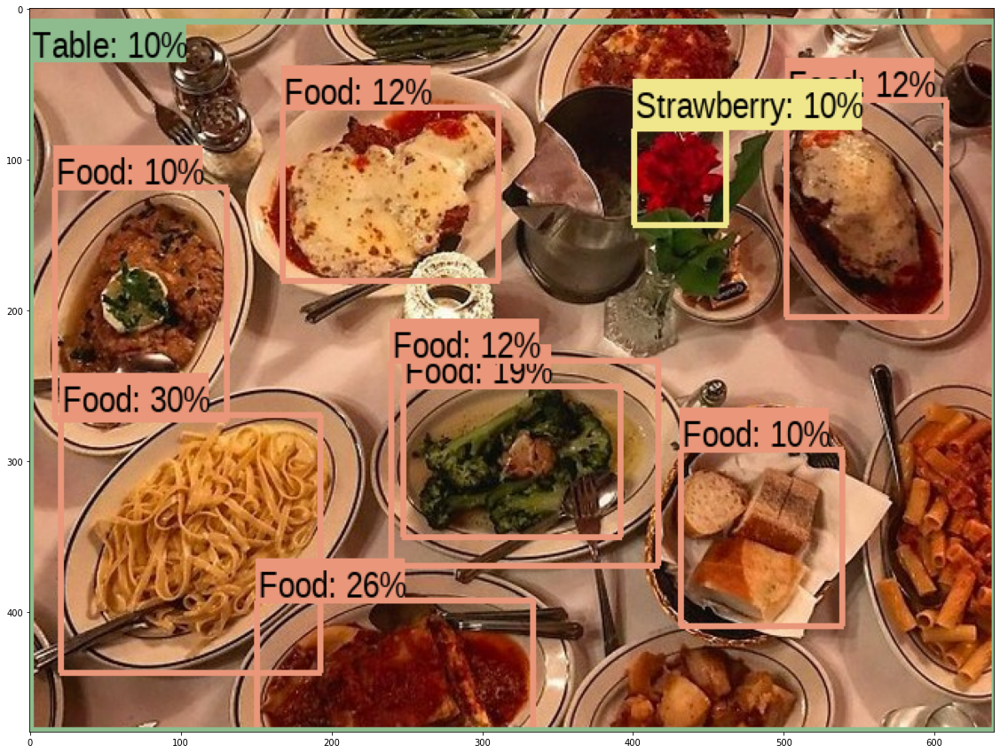

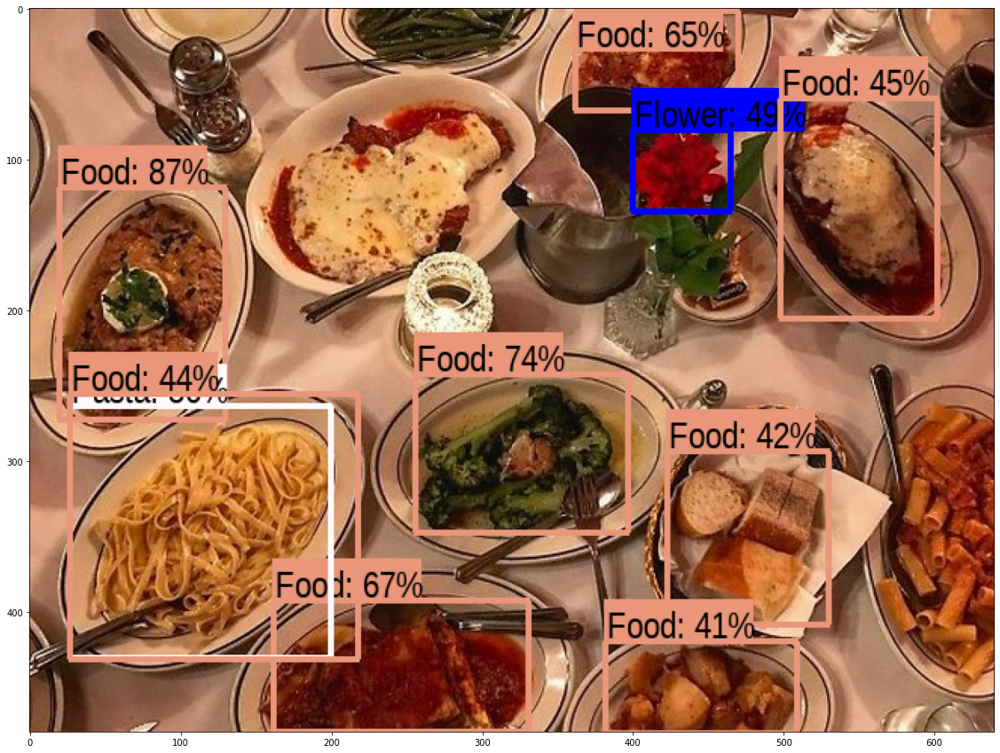

In [ ]:
print('SSD')  
%memit detect_imgSSD(image_urls[1])
print('\nRCNN')
%memit detect_imgRCNN(image_urls[1])

SSD
Image downloaded to /tmp/tmp079gk2bs.jpg.
Found 100 objects.
Inference time:  0.28858494758605957
peak memory: 6008.20 MiB, increment: 0.11 MiB

RCNN
Image downloaded to /tmp/tmpad66duw6.jpg.
Found 100 objects.
Inference time:  31.71973943710327
peak memory: 6008.09 MiB, increment: 0.00 MiB


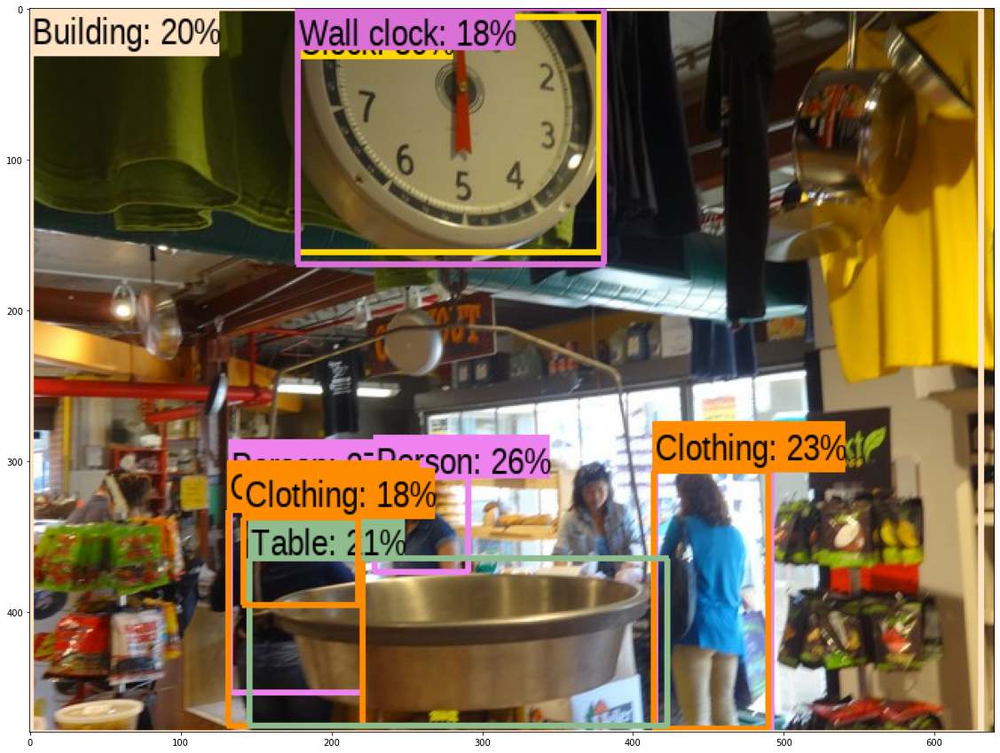

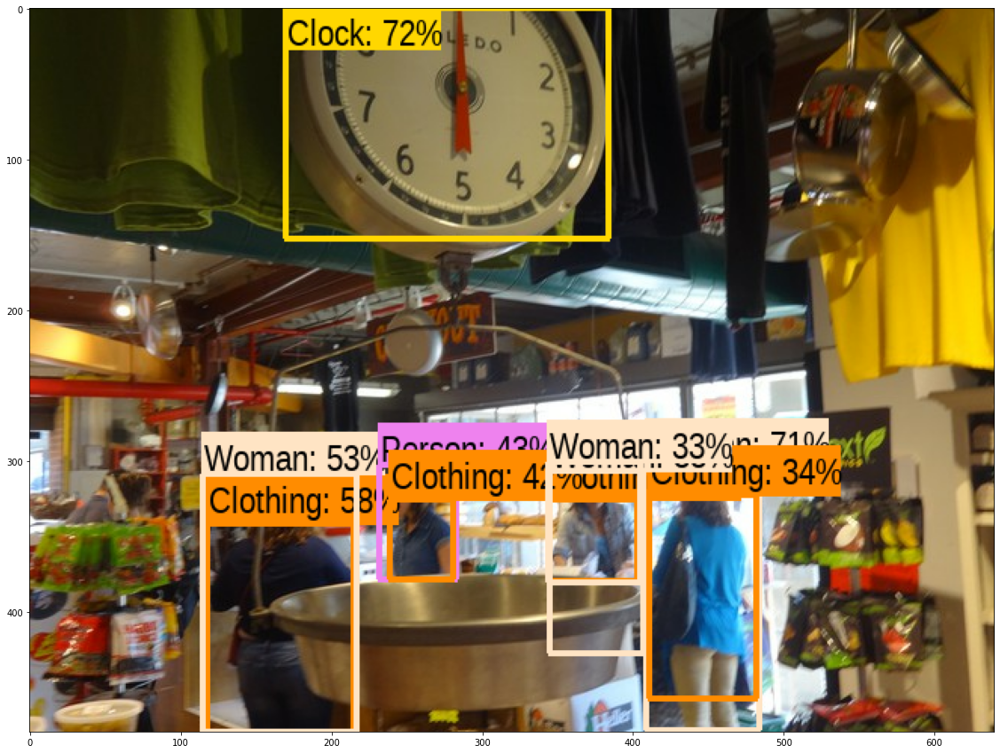

In [ ]:
print('SSD') 
%memit detect_imgSSD(image_urls[2])
print('\nRCNN') 
%memit detect_imgRCNN(image_urls[2])

SSD
Image downloaded to /tmp/tmpkx1wdvbp.jpg.
Found 100 objects.
Inference time:  0.30602025985717773
peak memory: 6008.09 MiB, increment: 0.00 MiB

RCNN
Image downloaded to /tmp/tmpdrwm5xrx.jpg.
Found 100 objects.
Inference time:  34.811490058898926
peak memory: 6008.20 MiB, increment: 0.11 MiB


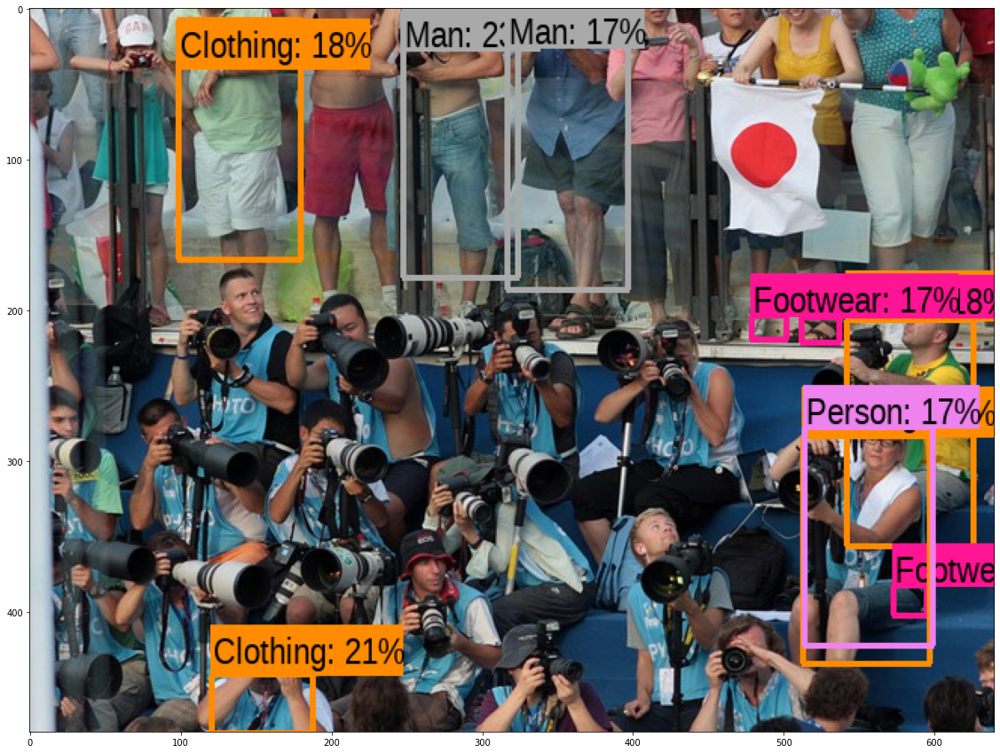

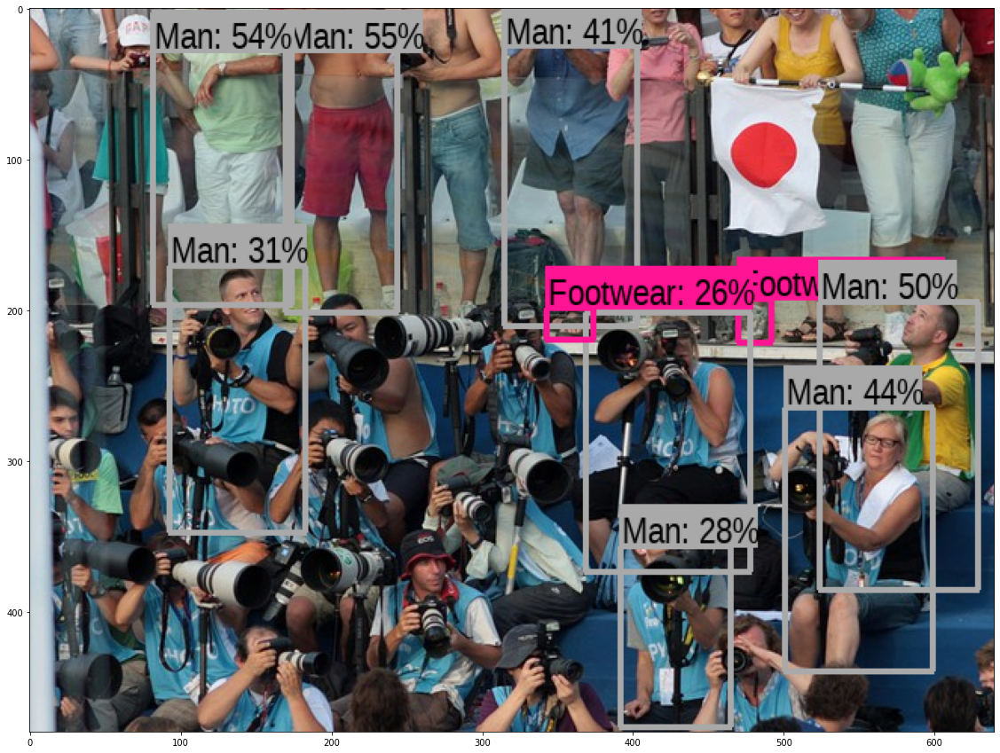

In [ ]:
 print('SSD') 
 %memit detect_imgSSD(image_urls[3])
 print('\nRCNN') 
 %memit detect_imgRCNN(image_urls[3])

**A Comaparitive Study :**

We have used the following parameters to show the distinctions between Faster R-CNN (Based on region proposals) and SSD (Single Shot Multibox Detector).

1. **Memory Usage:** We used the URLs of the models above to observe that the Faster R-CNN model consumes of memory while the SSD model consumes merely. This is due to the inherent architecture of Faster R-CNN that implements the region proposal network in addition to the neural network required for processing the regions for image classification and bounding box detection. SSD on the other hand
2. **Inference Time:** We can see in above comaprision that RCNN requires more infeence time than SSD for infering objects in the same image.
3. **Accuracy:** Accuracywise, Faster RCNN is more accurate than SSD due to its more robust two shot architecture as compared to single shot light weight SSD. IN some of the images we can see that SSD is not able to pick smaller objects whereas RCNN is able to detect it. At the same time we can see that RCNN is able to identify more objects in total than SSD in many test images above.


## **Conclusion:**

In conclusion, SSD with MobileNet seems to be a good  balance between speed and accuracy as we are able to run it on a video and the accuracy trade-off is very little. However, it may not be that accurate when we compare its performance with the performance of SSD, YOLO, and Faster-RCNN on small sized objects. At large sizes, SSD seems to perform similarly to Faster-RCNN. However,the accuracy numbers widens when the object size is small.


